\begin{equation}
I=C_{m} \frac{\mathrm{d} V}{\mathrm{d} T}+\bar{g_{Na}}m^{3}_{1}h^{1}_{1}(V-50)+\bar{g_{CaT}}m^{3}_{2}h^{1}_{2}(V-0)+\bar{g_{CaS}}m^{3}_{3}h^{1}_{3}(V-0)+\bar{g_{A}}m^{3}_{4}h^{1}_{4}(V+80)+\bar{g_{KCa}}m^{4}_{5}
(V+80)+\bar{g_{Kd}}m^{4}_{6}(V+80)+\bar{g_{H}}m^{1}_{7}(V+20)+0.01(V+50)
\end{equation}

donde 
\begin{equation}
\frac{\mathrm{d} V}{\mathrm{d} T} =\frac{1}{C} (I -(\bar{g_{Na}}m^{3}_{1}h^{1}_{1}(V-50)+\bar{g_{CaT}}m^{3}_{2}h^{1}_{2}(V-0)+\bar{g_{CaS}}m^{3}_{3}h^{1}_{3}(V-0)+\bar{g_{A}}m^{3}_{4}h^{1}_{4}(V+80)+\bar{g_{KCa}}m^{4}_{5}
(V+80)+\bar{g_{Kd}}m^{4}_{6}(V+80)+\bar{g_{H}}m^{1}_{7}(V+20)+0.01(V+50)))
\end{equation}

\begin{equation}
\tau_{m_{i}} \frac{\mathrm{d} m_{i}}{\mathrm{d} t}=m_{\propto_{i} }-m_{i}
\end{equation}

\begin{equation}
\tau_{h_{i}} \frac{\mathrm{d} h}{\mathrm{d} t}=h_{\propto_{i}}-h_{i}
\end{equation}

donde 

<img src="ales.png">

ademas la concentracion de calcio usado para controlar $I_{Ca}$ esta determinada por 
\begin{equation}
(20milisec)\frac{\mathrm{d} [Ca^{2+}]}{\mathrm{d} t}=-0.94(I_{Ca})-[Ca^{2+}]+0.05
\end{equation}

In [1]:
using Plots

In [5]:
boltz(V::Float64,A::Float64,B::Float64)= 1/(1 + exp((V+A)/B))

tauX(V::Float64,A::Float64,B::Float64,D::Float64,E::Float64)= A - (B*boltz(V,D,E))

minf1(V::Float64) = boltz(V,25.5,-5.29)
taum1(V::Float64) = tauX(V,1.32,1.26,120.,-25.)
hinf1(V::Float64) = boltz(V,48.9,5.18)
tauh1(V::Float64) = (0.67/(1+exp((V+62.9)/-10.0)))*(1.5 + 1/(1+exp((V+34.9)/3.6)))
minf2(V::Float64) = boltz(V,27.1,-7.2)
taum2(V::Float64) = tauX(V,21.7,21.3,68.1,-20.5)
hinf2(V::Float64) = boltz(V,32.1,5.5)
tauh2(V::Float64) = tauX(V,105.,89.8,55.,-16.9)
minf3(V::Float64) = boltz(V,33.,-8.1)
taum3(V::Float64) = (1.4 + (7/((exp((V+27)/10))+(exp((V+70)/-13)))))
hinf3(V::Float64) = boltz(V,60.,6.2)
tauh3(V::Float64) = 60 + (150/((exp((V+55)/9))+(exp((V+65)/-16))))
minf4(V::Float64) = boltz(V,27.2,-8.7)
taum4(V::Float64) = tauX(V,11.6,10.4,32.9,-15.2)
hinf4(V::Float64) = boltz(V,56.9,4.9)
tauh4(V::Float64) = tauX(V,38.6,29.2,38.9,-26.5)
taum5(V::Float64) = tauX(V,90.3,75.1,46.,-22.7)
minf6(V::Float64) = boltz(V,12.3,-11.8)
taum6(V::Float64) = tauX(V,7.2,6.4,28.3,-19.2)
minf7(V::Float64) = boltz(V,70.,6.)
taum7(V::Float64) = tauX(V,272.,-1499.,42.2,-8.73)
minf5(V::Float64,Ca::Float64) = (Ca/(Ca+3))*(1/(1+exp((V+28.3)/-12.6)))

minf5 (generic function with 1 method)

In [6]:
######
const ENa=50.
const ECa=100.
const EK=-80.
const EH=-20.
const EL=-5.  
const C=1.

######
##h es el paso generalmente se construye a travez de b-a/2
##t va a ser el tiempo 
##p son parametros iniciales
##r son las condiciones inciales 


function stgjafet(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
    
        V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
        Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
        mNa+= h/taum1(V)*(minf1(V)-mNa)
        mCaT+= h/taum2(V)*(minf2(V)-mCaT)
        mCaS+= h/taum3(V)*(minf3(V)-mCaS)
        mA+= h/taum4(V)*(minf4(V)-mA)
        mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
        mKd+= h/taum6(V)*(minf6(V)-mKd)
        mH+= h/taum7(V)*(minf7(V)-mH)
        
        hNa += h/tauh1(V)*(hinf1(V)-hNa)
        hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
        hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
        hA += h/tauh4(V)*(hinf4(V)-hA)
        
        gNa += h/taugg*(mgNa-gNa)
        gCaT += h/taugg*(mgCaT-gCaT)
        gCaS += h/taugg*(mgCaS-gCaS)
        gA += h/taugg*(mgA-gA)
        gKCa += h/taugg*(mgKCa-gKCa)
        gKd += h/taugg*(mgKd-gKd)
        gH += h/taugg*(mgH-gH)
        
        mgNa += h/taumm*gtgtNa*(catgt-Ca2)
        mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
        mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
        mgA += h/taumm*gtgtA*(catgt-Ca2)
        mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
        mgKd += h/taumm*gtgtKd*(catgt-Ca2)
        mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet (generic function with 1 method)

In [7]:
t=range(0,150000,length=1500000)

0.0:0.10000006666671112:150000.0

In [10]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v,Ca2,gna,gcat,gcas,ga,gkca,gkd,gh=stgjafet(0.001,150000000,p,r)

 64.865760 seconds (147.42 k allocations: 110.163 MiB, 0.05% gc time)


([-19.985157274233107, -19.970179532807524, -19.9552167627878, -19.94026894975065, -19.92533607928452, -19.910418136988916, -19.89551510847344, -19.880626979356705, -19.86575373526511, -19.850895361831657  …  -9.176738201441378, -12.16442731458053, -16.15400103337775, -24.127630483103076, -42.393613218874066, -53.25910828125914, -56.32774403369121, -56.90246111124783, -56.64297647163302, -56.10161550943705], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  161.4390086517712, 166.91330964382865, 172.28792242294296, 177.7952427414651, 184.47263778987357, 192.41727051553536, 199.88335056403142, 206.17630302790806, 211.1877304514756, 214.9818993585005], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6.52660109

In [36]:
default(framestyle= :box)
plot(t[490000:500000],v[490000:500000],xlabel="tiempo",ylabel="mV",legend =false)
savefig("prueba")

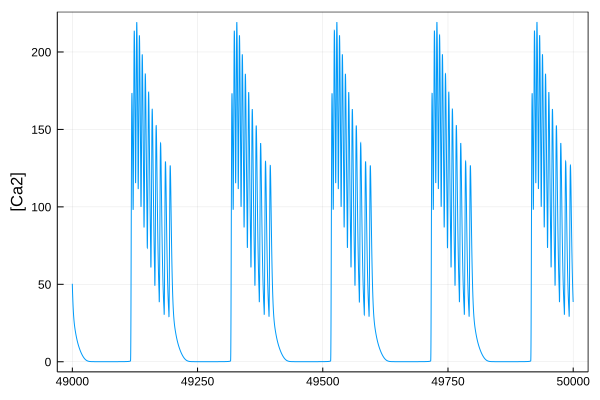

In [142]:
p1=plot(t[490000:500000],v[490000:500000],ylabel="mV",legend=false)
p2=plot(t[490000:500000],Ca2[490000:500000],ylabel="[Ca2]",legend=false)

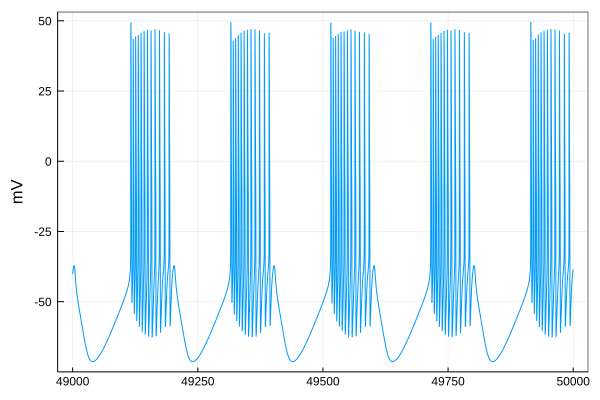

In [236]:
plot(p1,layout=1)

In [19]:
plot(t[1:100:1500000],log.(gna[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_burst_chidas")

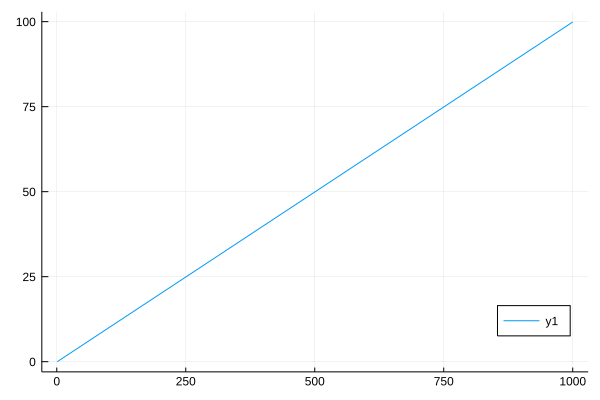

In [17]:
plot(t[1:1000],legend=:bottomright)

In [143]:
plot(p1,p2,layout=(2,1))
savefig("mas_chilo")
#plot(Ca2[490000:500000])

In [37]:
default(framestyle= :box)
plot(Ca2[490000:500000],xlabel="tiempo",ylabel="[Ca2]",legend = false )
savefig("prueba2")

para comparar

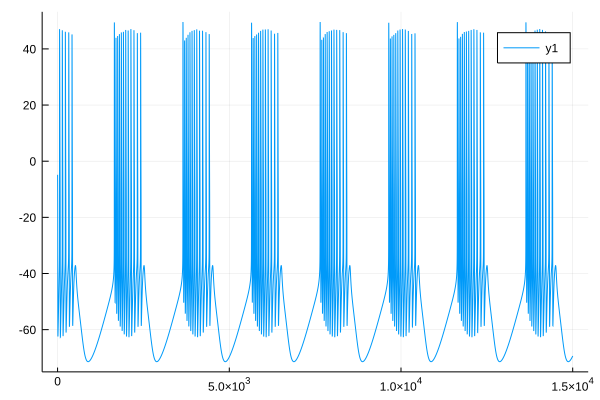

In [76]:
plot(v[895000:910000])

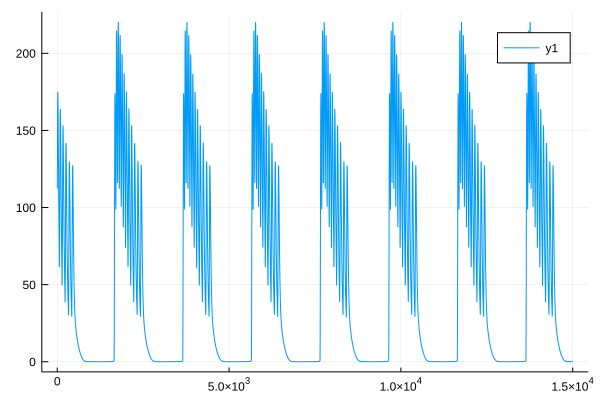

In [77]:
plot(Ca2[895000:910000])

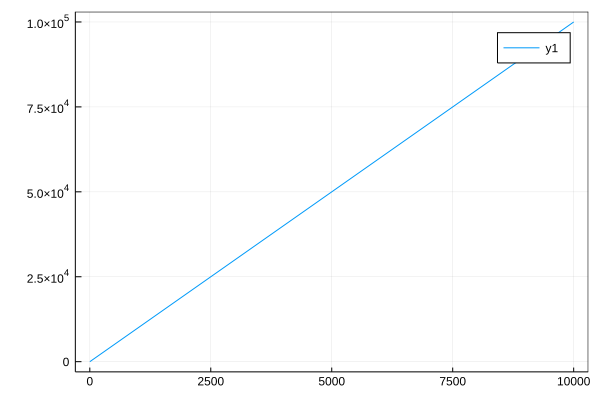

In [93]:
plot(t[1:100:1000000])

In [98]:
plot(t[1:100:1000000],log.(gna[1:100:1000000]),label="gNa",xlabel="tiempo",ylabel="Conductancias")
plot!(t[1:100:1000000],log.(gcat[1:100:1000000]),label="gCaT")
plot!(t[1:100:1000000],log.(gcas[1:100:1000000]),label="gCaS")
plot!(t[1:100:1000000],log.(ga[1:100:1000000]),label="gA")
plot!(t[1:100:1000000],log.(gkca[1:100:1000000]),label="gKCa")
plot!(t[1:100:1000000],log.(gkd[1:100:1000000]),label="gKd")
plot!(t[1:100:1000000],log.(gh[1:100:1000000]),label="gH")
savefig("ConductanciasPrueba")

# Quitando gCaT

In [3]:

function stgjafet_CaT_out(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
        if i>=90000000
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+0*gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(0*gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)*0
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        else
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
            
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        end
            
            
            
            
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet_CaT_out (generic function with 1 method)

In [8]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_1,Ca2_1,gna_1,gcat_1,gcas_1,ga_1,gkca_1,gkd_1,gh_1=stgjafet_CaT_out(0.001,150000000,p,r)

 58.638487 seconds (379.34 k allocations: 121.960 MiB, 0.26% gc time)


([-19.985157274233107, -19.970179532807524, -19.9552167627878, -19.94026894975065, -19.92533607928452, -19.910418136988916, -19.89551510847344, -19.880626979356705, -19.86575373526511, -19.850895361831657  …  -46.07133344804245, -45.92237755528153, -45.77280526278636, -45.62243092045187, -45.47105196815128, -45.31844649686797, -45.16437033310762, -45.00855353446309, -44.8506961522217, -44.69046307408713], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  7.957244335389693, 7.899810068064218, 7.84374907969854, 7.789034539244213, 7.735641034634844, 7.683544551435443, 7.632722456262669, 7.58315348514351, 7.534817737006152, 7.487696672517071], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6.52660109759128e-6, 

In [21]:
plot(t[1:100:1500000],log.(gna_1[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_1[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_1[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_1[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_1[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_1[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_1[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_bursting_gcat")

In [62]:
p1=plot(t[900000:1500000],v_1[900000:1500000],legend=false,ylabel="mV")
p2=plot(t[900000:1500000],Ca2_1[900000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("bursting_tiempoentero_gcat")

In [61]:
p1=plot(t[1490000:1500000],v_1[1490000:1500000],legend=false,ylabel="mV")
p2=plot(t[1490000:1500000],Ca2_1[1490000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("busrting_tiempofinal_gcat")

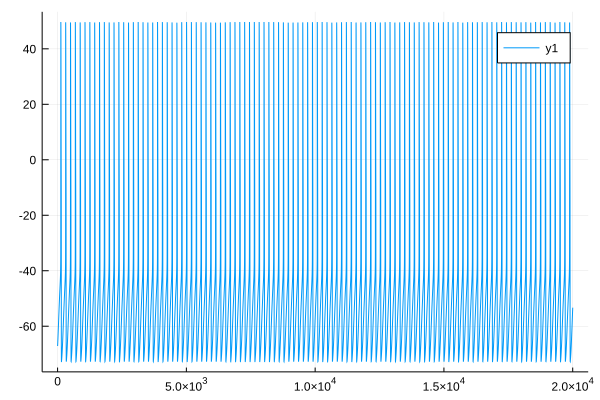

In [31]:
plot(v_1[10<gvlo,vgkñmbglkgb klbg0<0000:1100000])

In [179]:
p_prueba=plot(t[880000:920000],v_1[880000:920000],legend=false,ylabel="mV")
p_prueba2=plot(t[880000:920000],Ca2_1[880000:920000],legend=false,xlabel="tiempo",ylabel="[ca2]")
plot(p_prueba,p_prueba2,layout=(2,1))
savefig("gcat_doble")

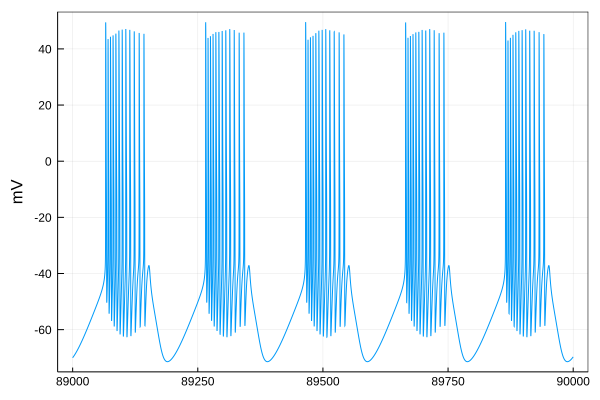

In [145]:
p1_Gca=plot(t[890000:900000],v_1[890000:900000],ylabel="mV",legend=false)

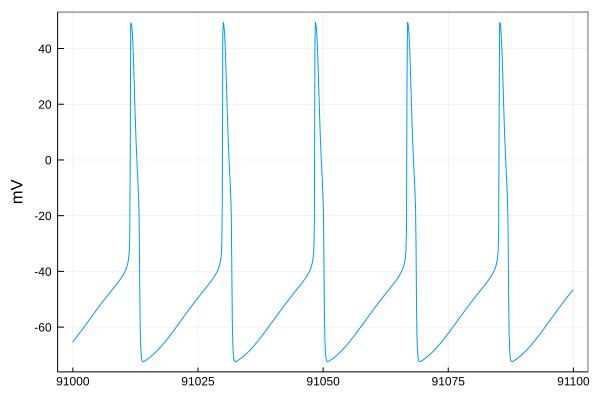

In [146]:
p2_Gca=plot(t[910000:911000],v_1[910000:911000],ylabel="mV",legend=false)

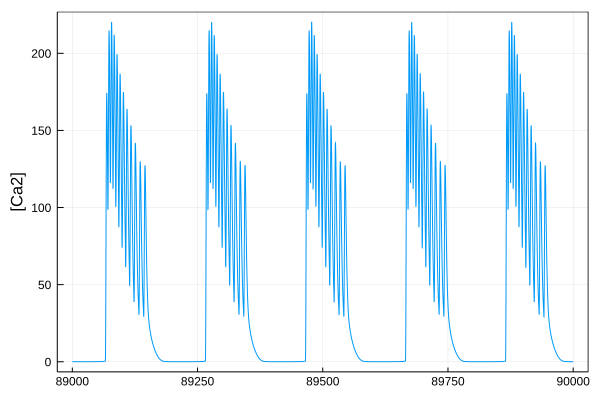

In [147]:
p3_Gca=plot(t[890000:900000],Ca2_1[890000:900000],ylabel="[Ca2]",legend=false)

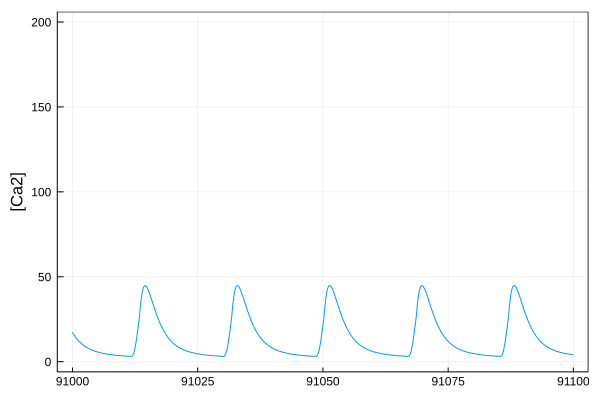

In [151]:
p4_Gca=plot(t[910000:911000],Ca2_1[910000:911000],ylim=[0,200],ylabel="[Ca2]",legend=false)

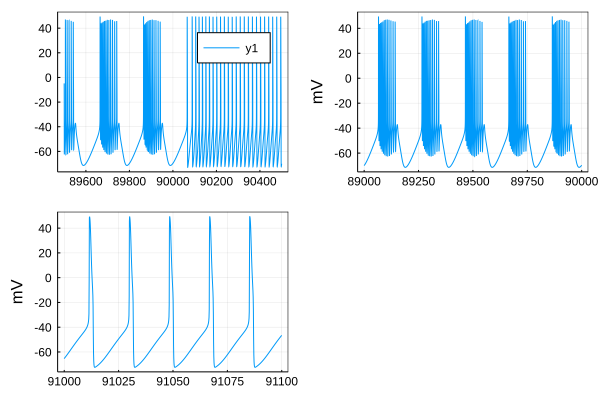

In [232]:
@layout [ a ; b c ]
plot(p_prueba,p1_Gca,p2_Gca,layout=3)

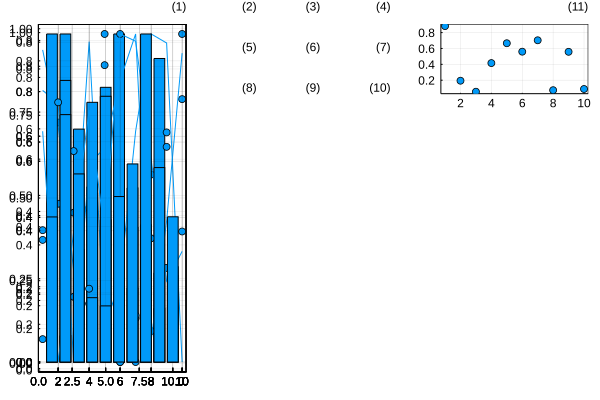

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [235]:
l = @layout [ a{0.3w} [grid(3,3)           b{0.2h}  ]]
plot(
    rand(10, 11),
    layout = l, legend = false, seriestype = [:bar :scatter :path],
    title = ["($i)" for j in 1:1, i in 1:11], titleloc = :right, titlefont = font(8)
)

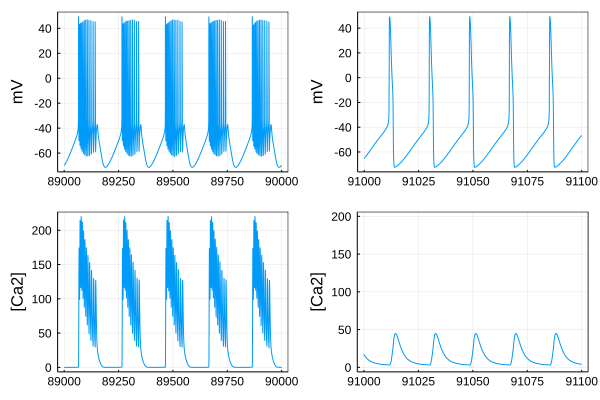

In [224]:
plot(p1_Gca,p2_Gca,p3_Gca,p4_Gca,layout=(2,2))
#savefig("quit_gCat")
#plot(Ca2[490000:500000])

# Quitando gH

In [63]:

function stgjafet_H_out(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
        if i>=90000000
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+0*gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)*0
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        else
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
            
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        end
            
            
            
            
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet_H_out (generic function with 1 method)

In [64]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_2,Ca2_2,gna_2,gcat_2,gcas_2,ga_2,gkca_2,gkd_2,gh_2=stgjafet_H_out(0.001,150000000,p,r)

 73.225750 seconds (213.78 k allocations: 113.118 MiB)


([-19.985157274233107, -19.970179532807524, -19.9552167627878, -19.94026894975065, -19.92533607928452, -19.910418136988916, -19.89551510847344, -19.880626979356705, -19.86575373526511, -19.850895361831657  …  -47.25205334393728, -47.199766150255904, -47.14724344033676, -47.09447897098523, -47.04146629542294, -46.98819875462181, -46.93466946816577, -46.88087132460809, -46.8267969712909, -46.77243880358953], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  0.1183025123708635, 0.11927923123753141, 0.12027227160803514, 0.12128198123954795, 0.12230871796907661, 0.12335285010666783, 0.1244147568481286, 0.1254948287084368, 0.12659346797709994, 0.12771108919681134], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6

In [67]:
p1=plot(t[900000:1500000],v_2[900000:1500000],legend=false,ylabel="mV")
p2=plot(t[900000:1500000],Ca2_2[900000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("bursting_tiempoentero_gh")

In [68]:
p1=plot(t[1490000:1500000],v_2[1490000:1500000],legend=false,ylabel="mV")
p2=plot(t[1490000:1500000],Ca2_2[1490000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("busrting_tiempofinal_gh")

In [25]:
plot(t[1:100:1500000],log.(gna_2[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_2[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_2[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_2[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_2[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_2[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_2[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_bursting_gh")

In [165]:
pl1=plot(t[880000:920000],v_2[880000:920000],ylabel="mV",legend=false)
pl2=plot(t[880000:920000],Ca2_2[880000:920000],xlabel="tiempo",ylabel="[Ca2]",legend=false)
plot(pl1,pl2,layout=(2,1))
savefig("gh_doble")

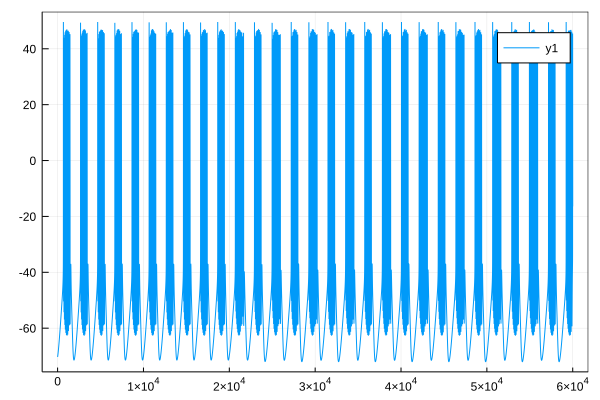

In [159]:
plot(v_2[880000:940000])

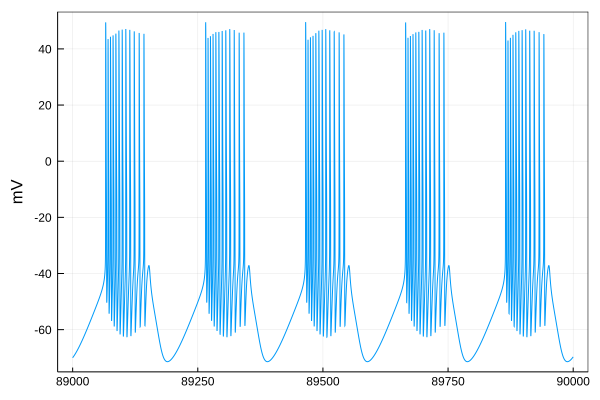

In [160]:
p1_Gh=plot(t[890000:900000],v_2[890000:900000],ylabel="mV",legend=false)

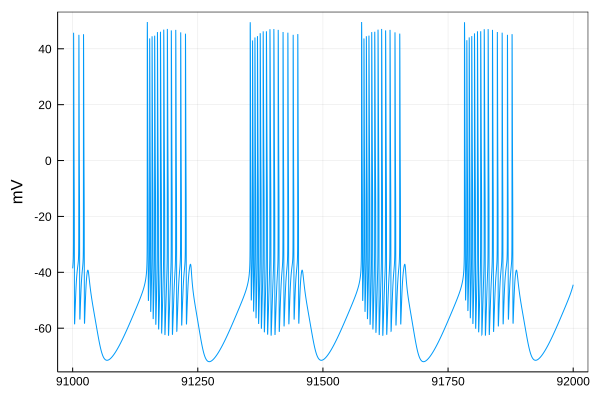

In [161]:
p2_Gh=plot(t[910000:920000],v_2[910000:920000],ylabel="mV",legend=false)

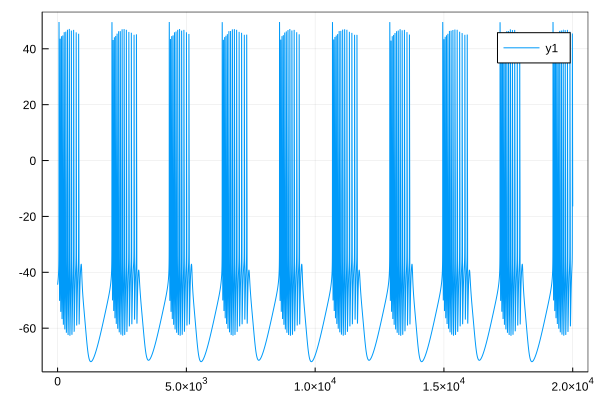

In [163]:
plot(v_2[920000:940000])

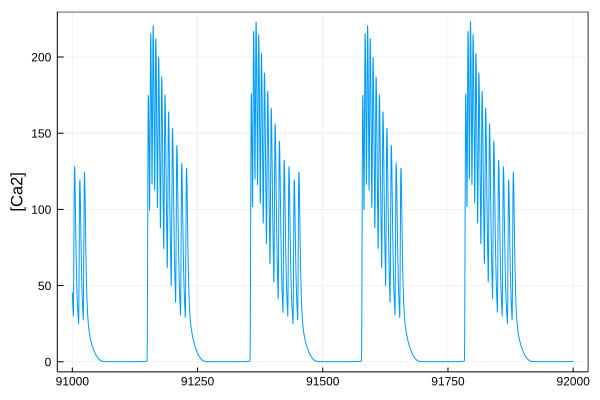

In [165]:
p4_Gh=plot(t[910000:920000],Ca2_2[910000:920000],ylabel="[Ca2]",legend=false)

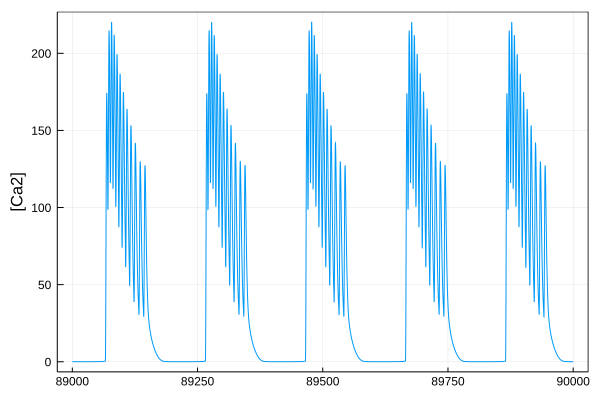

In [166]:
p3_Gh=plot(t[890000:900000],Ca2_2[890000:900000],ylabel="[Ca2]",legend=false)

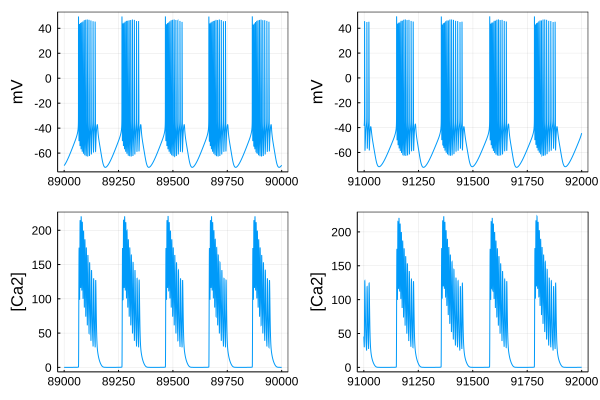

In [189]:
plot(p1_Gh,p2_Gh,p3_Gh,p4_Gh,layout=(2,2))
#savefig("quit_gH")
#plot(Ca2[490000:500000])

# Quitando gCaS

In [69]:

function stgjafet_CaS_out(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
        if i>=90000000
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+0*gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+0*gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)*0
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        else
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
            
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        end
            
            
            
            
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet_CaS_out (generic function with 1 method)

In [70]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_3,Ca2_3,gna_3,gcat_3,gcas_3,ga_3,gkca_3,gkd_3,gh_3=stgjafet_CaS_out(0.001,150000000,p,r)

 66.831163 seconds (212.35 k allocations: 113.037 MiB, 0.04% gc time)


([-19.985157274233107, -19.970179532807524, -19.9552167627878, -19.94026894975065, -19.92533607928452, -19.910418136988916, -19.89551510847344, -19.880626979356705, -19.86575373526511, -19.850895361831657  …  -50.292400765101775, -49.82627102478953, -49.36769009642393, -48.917044119852754, -48.47466079175548, -48.04080351790656, -47.61566575409222, -47.199365567527245, -46.7919404202105, -46.3933421311212], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  314.84986095690806, 307.0765466482376, 299.05512866224905, 290.84522598423206, 282.50028813661265, 274.06813810387723, 265.5914634496225, 257.1082612288418, 248.65224176835574, 240.25319588953545], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6.52660109

In [74]:
p1=plot(t[900000:1500000],v_3[900000:1500000],legend=false,ylabel="mV")
p2=plot(t[900000:1500000],Ca2_3[900000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("bursting_tiempoentero_gcas")

In [75]:
p1=plot(t[1490000:1500000],v_3[1490000:1500000],legend=false,ylabel="mV")
p2=plot(t[1490000:1500000],Ca2_3[1490000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("busrting_tiempofinal_gcas")

In [29]:
plot(t[1:100:1500000],log.(gna_3[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_3[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_3[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_3[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_3[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_3[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_3[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_bursting_gcas")

In [186]:
p1_11=plot(t[880000:920000],v_3[880000:920000],legend=false,ylabel="mV")
p2_11=plot(t[880000:920000],Ca2_3[880000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1_11,p2_11,layout=(2,1))
savefig("gcas_doble")

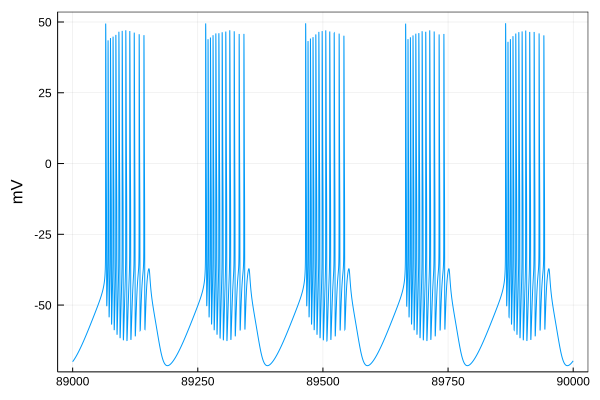

In [195]:
p1_gcas=plot(t[890000:900000],v_3[890000:900000],ylim=[-70,50],ylabel="mV",legend=false)

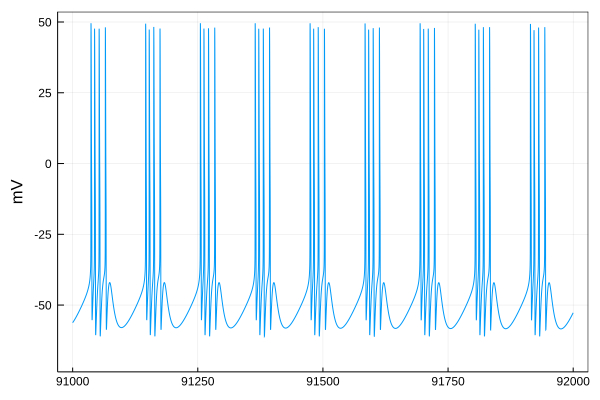

In [196]:
p2_gcas=plot(t[910000:920000],v_3[910000:920000],ylim=[-70,50],ylabel="mV",legend=false)

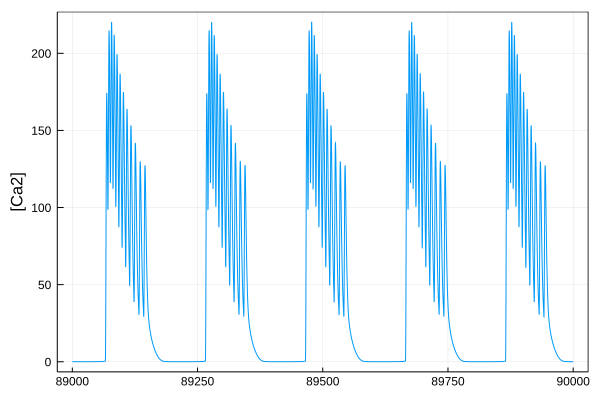

In [186]:
p3_gcas=plot(t[890000:900000],Ca2_3[890000:900000],ylabel="[Ca2]",legend=false)

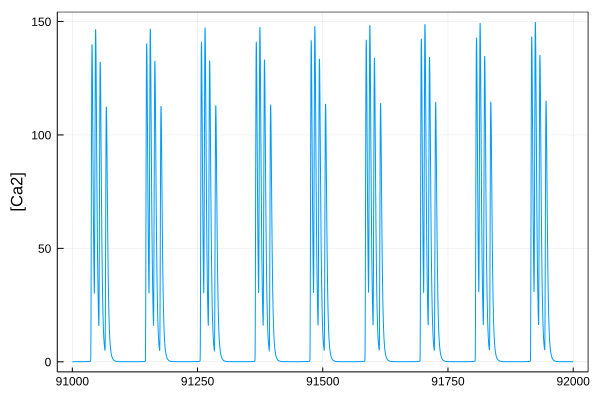

In [198]:
p4_gcas=plot(t[910000:920000],Ca2_3[910000:920000],ylabel="[Ca2]",legend=false)


In [200]:
plot(p1_gcas,p2_gcas,p3_gcas,p4_gcas,layout=(2,2))
savefig("quit_gcas")
#plot(Ca2[490000:500000])

# TonicSpiking

In [30]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v,Ca2,gna,gcat,gcas,ga,gkca,gkd,gh=stgjafet(0.001,150000000,p,r)

 65.773324 seconds (32 allocations: 102.998 MiB)


([-19.985157274237704, -19.97017953284555, -19.95521676291782, -19.94026895006118, -19.92533607989425, -19.91041813804697, -19.895515110159558, -19.880626981881413, -19.865753738869927, -19.850895366789285  …  -46.04439830074182, -45.98401245263643, -45.923318444805325, -45.862331696219684, -45.80106760387755, -45.73954148571738, -45.67776852569957, -45.61576372101418, -45.55354183136944, -45.4911173303076], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  13.76211447893763, 13.530698544958147, 13.306172704062833, 13.088284486181438, 12.87679152678248, 12.671461158585673, 12.47207001929068, 12.278403674797831, 12.090256257400549, 11.90743011843449], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6.52660109

In [32]:
plot(t[1:100:1500000],log.(gna[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_tonic_chidas")

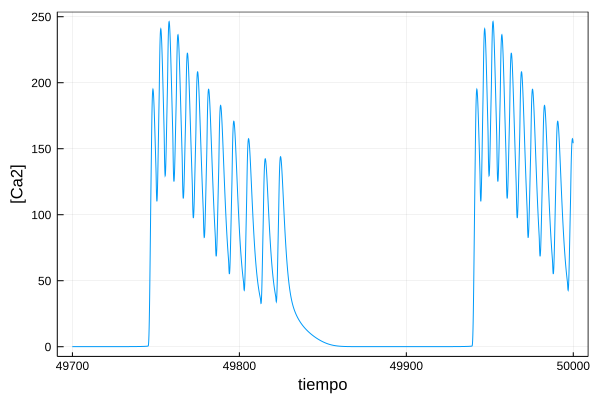

In [136]:
default(framestyle = :box)
p1=plot(t[497000:500000],v[497000:500000],ylabel="mV",xlabel="tiempo",legend=false)
p2=plot(t[497000:500000],Ca2[497000:500000],ylabel="[Ca2]",xlabel="tiempo",legend=false)

In [140]:
log.(gna)

1500000-element Array{Float64,1}:
 -16.383683715203944
 -14.978827265073619
 -14.159662895735499
 -13.57874928329493 
 -13.128071142058484
 -12.759682099911428
 -12.448055604375117
 -12.177972706804457
 -11.939624255914813
 -11.726315742573634
 -11.533273489226813
 -11.356973168762865
 -11.194738339659361
   ⋮                
   6.505503067332414
   6.505503064965687
   6.505503062787461
   6.505503060798974
   6.505503059001428
   6.505503057395989
   6.505503055983788
   6.505503054765922
   6.505503053743453
   6.50550305291742 
   6.505503052288824
   6.50550305185864 

In [143]:
plot(t[1:100:1000000],log.(gna[1:100:1000000]),label="gNa",xlabel="tiempo",ylabel="Conductancias")
plot!(t[1:100:1000000],log.(gcat[1:100:1000000]),label="gCaT")
plot!(t[1:100:1000000],log.(gcas[1:100:1000000]),label="gCaS")
plot!(t[1:100:1000000],log.(ga[1:100:1000000]),label="gA")
plot!(t[1:100:1000000],log.(gkca[1:100:1000000]),label="gKCa")
plot!(t[1:100:1000000],log.(gkd[1:100:1000000]),label="gKd")
plot!(t[1:100:1000000],log.(gh[1:100:1000000]),label="gH")
savefig("Conductancias_tonic")

In [28]:
default(framestyle= :box)
plot(p1,p2,layout=(2,1))
savefig("tonic_1")

In [82]:
default(framestyle= :box)
plot(v[100000:900000],xlabel="tiempo",ylabel="mV",legend =false)
#savefig("prueba")

# quit caT

In [76]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_1_2,Ca2_1_2,gna_1_2,gcat_1_2,gcas_1_2,ga_1_2,gkca_1_2,gkd_1_2,gh_1_2=stgjafet_CaT_out(0.001,150000000,p,r)

 67.053526 seconds (41 allocations: 102.998 MiB)


([-19.985157274237704, -19.97017953284555, -19.95521676291782, -19.94026895006118, -19.92533607989425, -19.91041813804697, -19.895515110159558, -19.880626981881413, -19.865753738869927, -19.850895366789285  …  -65.54605963768581, -65.44361888755076, -65.34118044753927, -65.23874915388456, -65.13632978883967, -65.03392708077511, -64.93154570431139, -64.82919028048498, -64.72686537694821, -64.62457550819933], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  0.05171242420611818, 0.05173481212058572, 0.051757932362324566, 0.05178179781652107, 0.05180642183342251, 0.051831818232351584, 0.05185800130603688, 0.05188498582525431, 0.051912787043772904, 0.051941420703600555], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.1424923305575

In [79]:
p1=plot(t[900000:1500000],v_1_2[900000:1500000],legend=false,ylabel="mV")
p2=plot(t[900000:1500000],Ca2_1_2[900000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("tonic_tiempoentero_gcat")

In [80]:
p1=plot(t[1490000:1500000],v_1_2[1490000:1500000],legend=false,ylabel="mV")
p2=plot(t[1490000:1500000],Ca2_1_2[1490000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("tonic_tiempofinal_gcat")

In [35]:
plot(t[1:100:1500000],log.(gna_1_2[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_1_2[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_1_2[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_1_2[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_1_2[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_1_2[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_1_2[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_tonic_gcat")

In [211]:
p_1=plot(t[890000:920000],v_1_2[890000:920000],legend=false,ylabel="mV")
p_2=plot(t[890000:920000],Ca2_1_2[890000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p_1,p_2,layout=(2,1))
savefig("tonicgcat_doble")

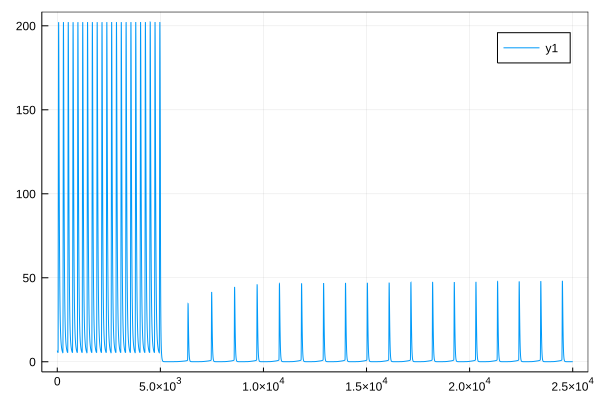

In [31]:
plot(Ca2_1_2[895000:920000])

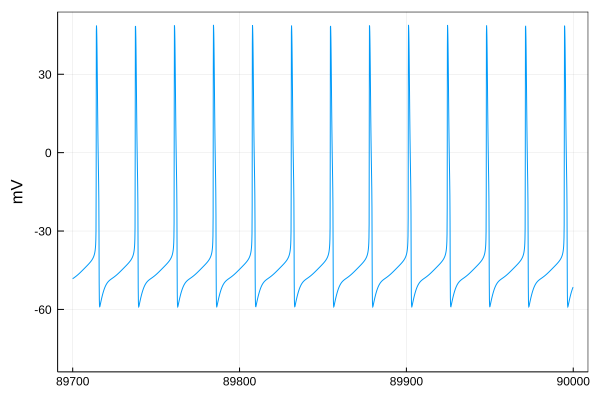

In [148]:
p1_1=plot(t[897000:900000],v_1_2[897000:900000],legend=false,ylim=[-80,50],ylabel="mV")

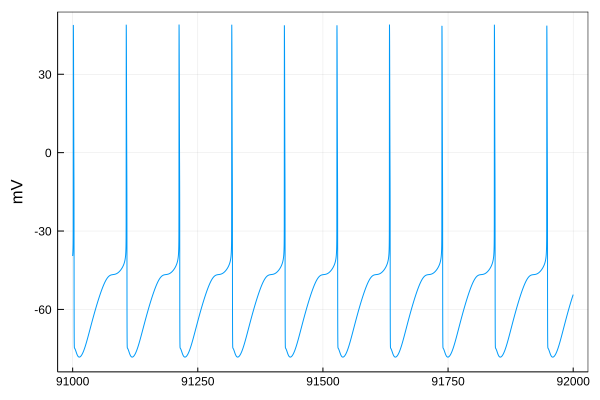

In [62]:
p2_1=plot(t[910000:920000],v_1_2[910000:920000],ylim=[-80,50],legend=false,ylabel="mV")

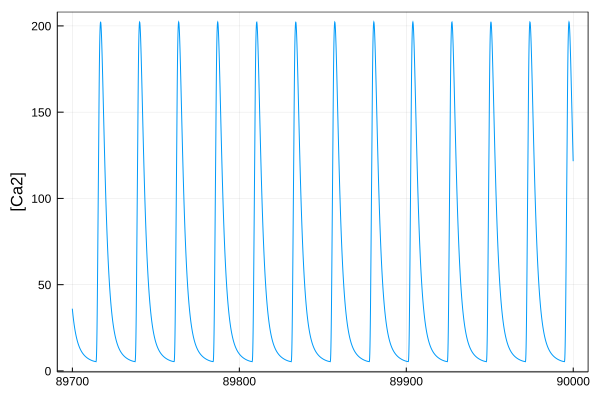

In [149]:
p3_1=plot(t[897000:900000],Ca2_1_2[897000:900000],legend=false,ylabel="[Ca2]")

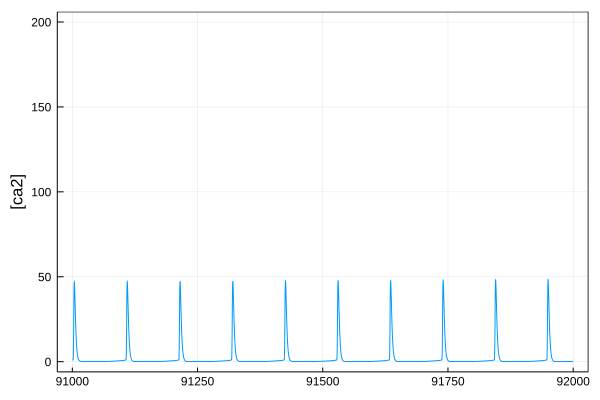

In [64]:
p4_1=plot(t[910000:920000],Ca2_1_2[910000:920000],legend=false,ylim=[0,200],ylabel="[ca2]")

In [151]:
plot(p1_1,p2_1,p3_1,p4_1)
savefig("tonic_sinCat")

In [81]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_2,Ca2_2,gna_2,gcat_2,gcas_2,ga_2,gkca_2,gkd_2,gh_2=stgjafet_H_out(0.001,150000000,p,r)

 70.768281 seconds (32 allocations: 102.998 MiB)


([-19.985157274237704, -19.97017953284555, -19.95521676291782, -19.94026895006118, -19.92533607989425, -19.91041813804697, -19.895515110159558, -19.880626981881413, -19.865753738869927, -19.850895366789285  …  -53.65319287012348, -53.43089528654331, -53.21491643817465, -53.00525428560704, -52.80189384248674, -52.604807398427376, -52.41395480704837, -52.229283837704294, -52.050730588121624, -51.87821995399746], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  171.50876684144978, 167.5123235822092, 163.4719469921167, 159.40649850821006, 155.33265322719888, 151.26510973651006, 147.21678041956397, 143.19896410096493, 139.22150271482022, 135.29292351444056], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6.5266

In [84]:
p1=plot(t[900000:1500000],v_2[900000:1500000],legend=false,ylabel="mV")
p2=plot(t[900000:1500000],Ca2_2[900000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("tonic_tiempoentero_gh")

In [85]:
p1=plot(t[1490000:1500000],v_2[1490000:1500000],legend=false,ylabel="mV")
p2=plot(t[1490000:1500000],Ca2_2[1490000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("tonic_tiempofinal_gh")

In [38]:
plot(t[1:100:1500000],log.(gna_2[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_2[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_2[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_2[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_2[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_2[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_2[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_tonic_gh")

In [200]:
plott_1h=plot(t[890000:920000],v_2[890000:920000],legend=false,ylabel="mV")
plott_2h=plot(t[890000:920000],Ca2_2[890000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(plott_1h,plott_2h,layout=(2,1))
savefig("tonicgh_doble")

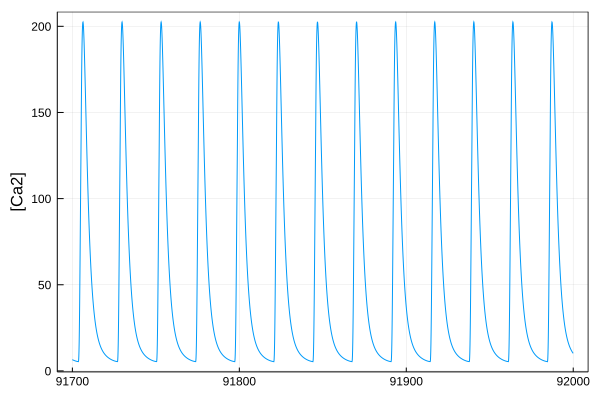

In [81]:
p1=plot(t[897000:900000],v_2[897000:900000],ylabel="mV",legend=false)
p2=plot(t[917000:920000],v_2[917000:920000],ylabel="mV",legend=false)
p3=plot(t[897000:900000],Ca2_2[897000:900000],ylabel="[Ca2]",legend=false)
p4=plot(t[917000:920000],Ca2_2[917000:920000],ylabel="[Ca2]",legend=false)

In [83]:
plot(p1,p2,p3,p4)
savefig("tonic_singH")

In [86]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_3,Ca2_3,gna_3,gcat_3,gcas_3,ga_3,gkca_3,gkd_3,gh_3=stgjafet_CaS_out(0.001,150000000,p,r)

 70.031657 seconds (32 allocations: 102.998 MiB)


([-19.985157274237704, -19.97017953284555, -19.95521676291782, -19.94026895006118, -19.92533607989425, -19.91041813804697, -19.895515110159558, -19.880626981881413, -19.865753738869927, -19.850895366789285  …  -51.32484916805867, -51.32485631378156, -51.324863459482955, -51.32487060516284, -51.324877750821244, -51.32488489645815, -51.324892042073564, -51.32489918766748, -51.324906333239895, -51.32491347879082], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  0.12118488898503842, 0.12118479301450438, 0.12118469704453913, 0.12118460107514273, 0.12118450510631514, 0.12118440913805632, 0.12118431317036632, 0.12118421720324515, 0.12118412123669275, 0.12118402527070912], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.1424923305575

In [96]:
p1=plot(t[900000:1500000],v_3[900000:1500000],legend=false,ylabel="mV")
p2=plot(t[900000:1500000],Ca2_3[900000:1500000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("tonic_tiempoentero_gcas")

In [97]:
p1=plot(t[1250000:1310000],v_3[1250000:1310000],legend=false,ylabel="mV")
p2=plot(t[1250000:1310000],Ca2_3[1250000:1310000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
savefig("tonic_tiempofinal_gcas")

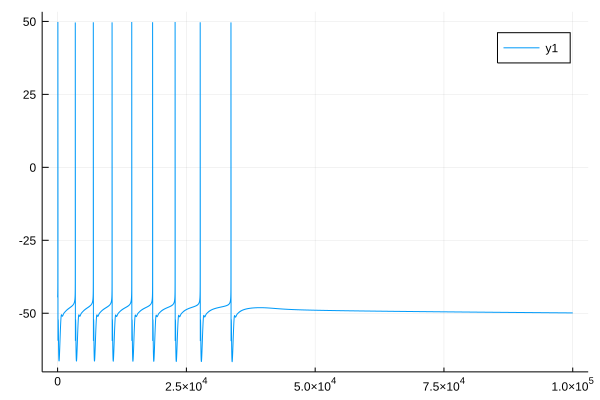

In [92]:
plot(v_3[1250000:1350000])

In [41]:
plot(t[1:100:1500000],log.(gna_3[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_3[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_3[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_3[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_3[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_3[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_3[1:100:1500000]),label="gH",legend=:bottomright)
savefig("Conductancias_tonic_gcas")

In [219]:
p111=plot(t[890000:920000],v_3[890000:920000],legend=false,ylabel="mV")
p222=plot(t[890000:920000],Ca2_3[890000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p111,p222,layout=(2,1))
savefig("tonicgcas_doble")

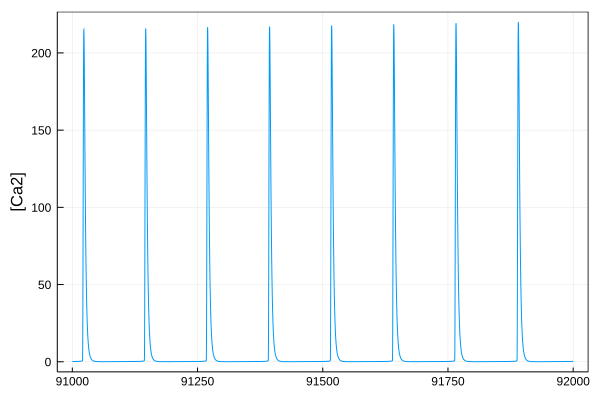

In [92]:
p1=plot(t[897000:900000],v_3[897000:900000],ylabel="mV",legend=false)
p2=plot(t[910000:920000],v_3[910000:920000],ylabel="mV",legend=false)
p3=plot(t[897000:900000],Ca2_3[897000:900000],ylabel="[Ca2]",legend=false)
p4=plot(t[910000:920000],Ca2_3[910000:920000],ylabel="[Ca2]",legend=false)

In [94]:
plot(p1,p2,p3,p4)
savefig("tonic_sincas")

Variando parametros en un 15%

# bursting

In [ ]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v,Ca2,gna,gcat,gcas,ga,gkca,gkd,gh=stgjafet(0.001,150000000,p,r)

In [101]:
p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

9-element Array{Float64,1}:
 -20.0
   5.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0

In [104]:
p[4:12]*0.15

9-element Array{Float64,1}:
 105.0   
   0.6   
   0.7875
   1.5   
   3.75  
  13.5   
   0.0015
   7.5   
   0.0015

In [107]:
p[4:12]+p[4:12]*0.15

9-element Array{Float64,1}:
 805.0   
   4.6   
   6.0375
  11.5   
  28.75  
 103.5   
   0.0115
  57.5   
   0.0115

In [108]:
p=Array{Float64}([0.0,2*10e2,10e5,805.,4.6,6.0375,11.5,28.75,103.5,0.0115,57.5,0.0115])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])
@time v,Ca2,gna,gcat,gcas,ga,gkca,gkd,gh=stgjafet(0.001,150000000,p,r)

 46.422694 seconds (32 allocations: 102.998 MiB, 0.43% gc time)


([-19.982932119708362, -19.965711553304917, -19.948510780724206, -19.93132977993805, -19.914168528939427, -19.897027005742174, -19.879905188380278, -19.862803054906784, -19.845720583392634, -19.828657751925437  …  -65.21441777840037, -65.17447891476529, -65.13447366432288, -65.0944023087445, -65.05426512897812, -65.0140624052624, -64.9737944171409, -64.93346144347524, -64.8930637624587, -64.85260165162865], [4.533204332628469, 4.106368074663282, 3.720169981386609, 3.370740980919193, 3.054580367412022, 2.768520729707348, 2.5096962190666012, 2.275513838059825, 2.0636274629782916, 1.8719143395174676  …  0.05070062452441402, 0.05070379308567576, 0.05070704335155616, 0.05071037566885214, 0.05071379040417408, 0.05071728794385279, 0.05072086869385557, 0.05072453307971058, 0.0507282815464397, 0.050732114558499804], [1.0282053487406871e-7, 4.1878582672234166e-7, 9.496257548884295e-7, 1.6968852810516037e-6, 2.661961174292088e-6, 3.8461161202431005e-6, 5.250491486940799e-6, 6.876118875265053e-6, 

In [110]:
@time v_,Ca2_,gna_,gcat_,gcas_,ga_,gkca_,gkd_,gh_=stgjafet_CaS_out(0.001,150000000,p,r)

 52.436056 seconds (41 allocations: 102.998 MiB, 0.10% gc time)


([-19.982932119708362, -19.965711553304917, -19.948510780724206, -19.93132977993805, -19.914168528939427, -19.897027005742174, -19.879905188380278, -19.862803054906784, -19.845720583392634, -19.828657751925437  …  -66.01821039604839, -65.99226275243986, -65.96612023904396, -65.93978447664651, -65.91325706685764, -65.88653959240627, -65.85963361743175, -65.83254068776967, -65.80526233123378, -65.7778000578936], [4.533204332628469, 4.106368074663282, 3.720169981386609, 3.370740980919193, 3.054580367412022, 2.768520729707348, 2.5096962190666012, 2.275513838059825, 2.0636274629782916, 1.8719143395174676  …  0.057091798315368376, 0.056936675779517054, 0.05678529022556558, 0.05663754980971016, 0.05649336498507588, 0.05635264844360417, 0.056215315059446644, 0.05608128183382401, 0.055950467841311705, 0.055822794177512916], [1.0282053487406871e-7, 4.1878582672234166e-7, 9.496257548884295e-7, 1.6968852810516037e-6, 2.661961174292088e-6, 3.8461161202431005e-6, 5.250491486940799e-6, 6.876118875265

In [115]:
@time v_,Ca2_,gna_,gcat_,gcas_,ga_,gkca_,gkd_,gh_=stgjafet_CaT_out(0.001,150000000,p,r)

 52.308851 seconds (32 allocations: 102.998 MiB)


([-19.982932119708362, -19.965711553304917, -19.948510780724206, -19.93132977993805, -19.914168528939427, -19.897027005742174, -19.879905188380278, -19.862803054906784, -19.845720583392634, -19.828657751925437  …  -49.705695998541266, -49.561077266909095, -49.41790768842393, -49.27615004078678, -49.13576497358769, -48.99671098929484, -48.8589444182866, -48.722419386854554, -48.58708777700403, -48.45289917676468], [4.533204332628469, 4.106368074663282, 3.720169981386609, 3.370740980919193, 3.054580367412022, 2.768520729707348, 2.5096962190666012, 2.275513838059825, 2.0636274629782916, 1.8719143395174676  …  10.550787185545735, 10.446622212133876, 10.344956245316874, 10.245715508461897, 10.148829217681202, 10.054229453757715, 9.961851040349805, 9.87163142821971, 9.783510585241835, 9.697430891958833], [1.0282053487406871e-7, 4.1878582672234166e-7, 9.496257548884295e-7, 1.6968852810516037e-6, 2.661961174292088e-6, 3.8461161202431005e-6, 5.250491486940799e-6, 6.876118875265053e-6, 8.7239305

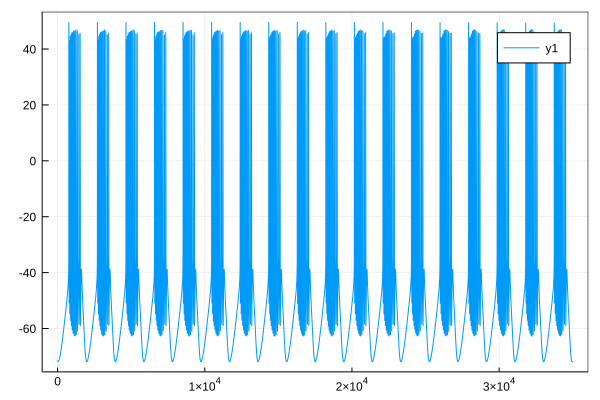

In [114]:
plot(v[875000:910000])

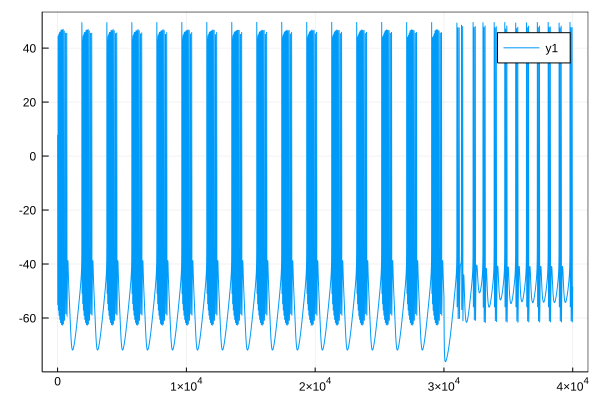

In [113]:
plot(v_[870000:910000])

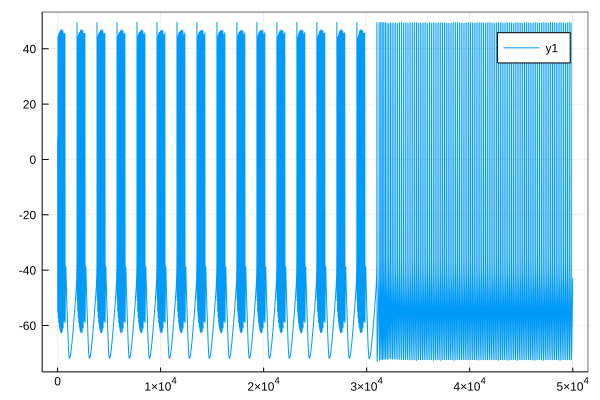

In [127]:
pfkr=plot(v_[870000:920000])

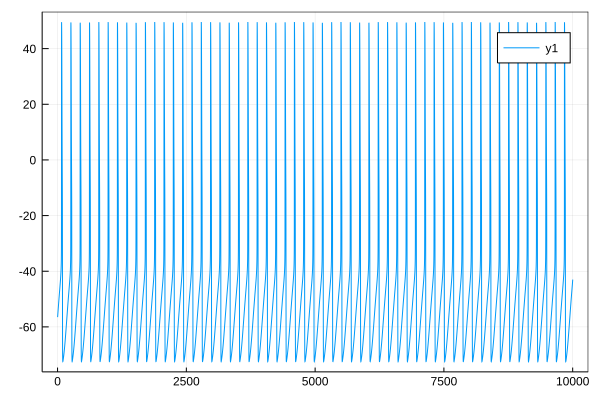

In [123]:
plot(v_[910000:920000])

In [125]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p1=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r1=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_1,Ca2_1,gna_1,gcat_1,gcas_1,ga_1,gkca_1,gkd_1,gh_1=stgjafet_CaT_out(0.001,150000000,p1,r1)

 48.763663 seconds (41 allocations: 102.998 MiB)


([-19.985157274233107, -19.970179532807524, -19.9552167627878, -19.94026894975065, -19.92533607928452, -19.910418136988916, -19.89551510847344, -19.880626979356705, -19.86575373526511, -19.850895361831657  …  -46.07133344804245, -45.92237755528153, -45.77280526278636, -45.62243092045187, -45.47105196815128, -45.31844649686797, -45.16437033310762, -45.00855353446309, -44.8506961522217, -44.69046307408713], [4.533204332607339, 4.106368074493033, 3.7201699808193975, 3.370740979598138, 3.0545803648809953, 2.7685207254198048, 2.5096962123935707, 2.2755138282971044, 2.0636274493529556, 1.8719143211937466  …  7.957244335389693, 7.899810068064218, 7.84374907969854, 7.789034539244213, 7.735641034634844, 7.683544551435443, 7.632722456262669, 7.58315348514351, 7.534817737006152, 7.487696672517071], [7.667549162190551e-8, 3.124481613926663e-7, 7.088209396222215e-7, 1.2671385835880785e-6, 1.9886169873737658e-6, 2.8743554506970526e-6, 3.925347779649349e-6, 5.142492330557539e-6, 6.52660109759128e-6, 

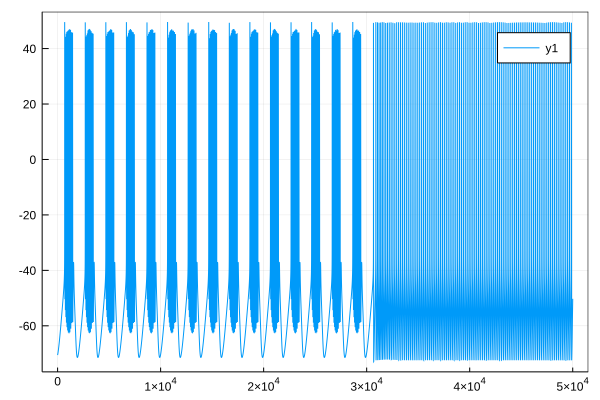

In [128]:
pfkr_2=plot(v_1[870000:920000])

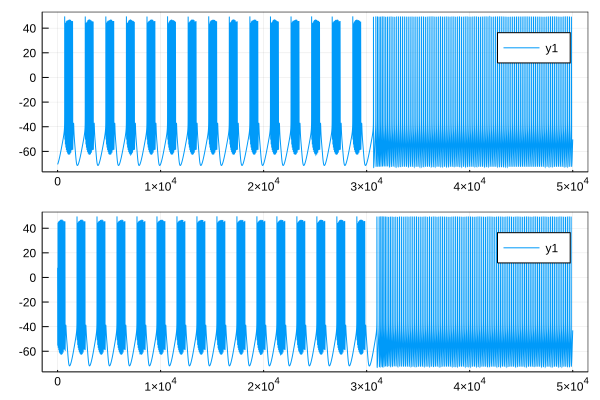

In [131]:
plot(pfkr_2,pfkr,layout=(2,1))